In [2]:
import numpy as np
import matplotlib.pyplot as plt

In [3]:
def stable_softmax(x):
    z = x - np.max(x, axis=-1, keepdims=True)
    numerator = np.exp(z)
    denominator = np.sum(numerator, axis=-1, keepdims=True)
    softmax = numerator / denominator
    return softmax


In [4]:
class Bandit:
    """Made with Normal distribution in mind"""
    def __init__(self,mean, variance=1):
        self.mean = mean
        self.variance = variance
    def pull(self):
        return np.random.normal(self.mean, self.variance)

In [5]:
class MAB:
    def __init__(self,numArms,mean = 0,variance_bandit=1,variance=1):
        self.numArms = numArms
        self.arms = [Bandit(np.random.normal(mean,variance_bandit),variance) for i in range(numArms)]
        self.mean = mean
        self.variance = variance
        self.variance_bandit = variance_bandit
        self.means = [b.mean for b in self.arms]
        self.bestAction = np.argmax(self.means)
    def pull(self,lever):
        reward = self.arms[lever].pull()
        return reward
    def reset(self):
        self.arms = [Bandit(np.random.normal(self.mean,self.variance_bandit),self.variance) for i in range(self.numArms)]
        means = [b.mean for b in self.arms]
        self.bestAction = np.argmax(means)



In [6]:
mab = MAB(10,10)

In [7]:
for arm in mab.arms:
    print(arm.mean,arm.variance,arm.pull())

9.495404717726228 1 10.926725917770625
9.655274736380306 1 11.209324098995292
10.419046407484691 1 9.442432329810872
10.378642170246206 1 10.986887557650046
12.433755999607309 1 13.127053726374703
8.76830223200532 1 7.669729624762613
8.978602719788405 1 10.694927422043712
9.62354694975308 1 10.761994162324434
11.337996672608583 1 11.454785999164129
10.924101218758487 1 11.714103447781167


In [8]:
class ValueLearner:
    def __init__(self,env_make,num_envs,method = 'e-greedy_alpha',epsilon = 0.1,alpha = 0.1,UCB_c =2,baseline=0,is_optimistic = False):
        """
        Available methods: 
            e-greedy_alpha
            Incremnetal 
            UCB_INC
            gradient
        """
        self.make_env = env_make
        self.num_envs = num_envs
        self.method = method
        if method == 'e-greedy_alpha' or method == 'gradient':
            self.epsilon = epsilon
            self.alpha = alpha
            if method == 'gradient':
                self.baseline=baseline
        elif method == 'Incremental' or method == 'UCB_INC':
            self.epsilon = epsilon
            if method == 'UCB_INC':
                self.UCB_c = UCB_c
        env = self.make_env()
        self.numArms  = env.numArms
        self.numPulls = np.zeros((num_envs,env.numArms))
        self.values = np.zeros((num_envs,env.numArms))
        self.envs = [self.make_env() for i in range(self.num_envs)]
    def learn(self,iters):
        acc =[]
        avg_reward = []
        if self.method=='Incremental' or self.method=='UCB_INC':
            for i in range(iters):
                best_action_times= 0
                rewards=[]
                for j in range(self.num_envs):
                    if np.random.rand()<self.epsilon:
                        action = np.random.randint(self.envs[j].numArms)
                    else:
                        if self.method=='UCB_INC':
                            
                            action = np.argmax(self.values[j]+ self.UCB_c * np.sqrt(np.log(i+1)/(self.numPulls[j]+1e-8)))
                        else:
                            action = np.argmax(self.values[j])
                    if self.envs[j].bestAction ==action:
                        best_action_times +=1
                    
                    reward = self.envs[j].pull(action)
                    rewards.append(reward)
                    self.numPulls[j][action] += 1
                    self.values[j][action] += (reward - self.values[j][action])/self.numPulls[j][action]
                average_reward = np.mean(rewards)
                avg_reward.append(average_reward)
                acc.append(best_action_times/self.num_envs)
        elif self.method=='e-greedy_alpha':
            for i in range(iters):
                best_action_times= 0
                rewards=[]
                for j in range(self.num_envs):
                    if np.random.rand()<self.epsilon:
                        action = np.random.randint(self.envs[j].numArms)
                    else:
                        action = np.argmax(self.values[j])
                    if self.envs[j].bestAction ==action:
                        best_action_times +=1
                    reward = self.envs[j].pull(action)
                    rewards.append(reward)
                    self.numPulls[j][action] += 1
                    self.values[j][action] += self.alpha*(reward - self.values[j][action])
                average_reward = np.mean(rewards)
                avg_reward.append(average_reward)
                acc.append(best_action_times/self.num_envs)
        elif self.method == 'gradient':
            for i in range(iters):
                best_action_times= 0
                rewards=[]
                for j in range(self.num_envs):
                    h_t = stable_softmax(self.values[j])
                    print(self.values[j])
                    if np.random.rand()<self.epsilon:
                        action = np.random.randint(self.envs[j].numArms)
                    else:
                        p=(h_t)/np.sum(h_t)
                        print(p,h_t)
                        action = np.random.choice(len(h_t),p= p)
                        
                    if self.envs[j].bestAction ==action:
                        best_action_times +=1
                    reward = self.envs[j].pull(action)
                    rewards.append(reward)
                    self.numPulls[j][action] += 1
                    for k in range(self.envs[0].numArms):
                        if k==action:
                            self.values[j][k]+= self.alpha*(reward -self.baseline)*(1-h_t[k])
                        else:
                            self.values[j][k]-= self.alpha*(reward -self.baseline)*(h_t[k])
        return acc,avg_reward

In [9]:
make_env = lambda: MAB(10)
num_envs = 1000

In [40]:
avRs_INC =[]
Accs_INC = []
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [41]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='Incremental',epsilon=epsilon,alpha=0.01)
    acc,avR = val.learn(1000)
    avRs_INC.append(avR)
    Accs_INC.append(acc)

Text(0, 0.5, 'Average Reward')

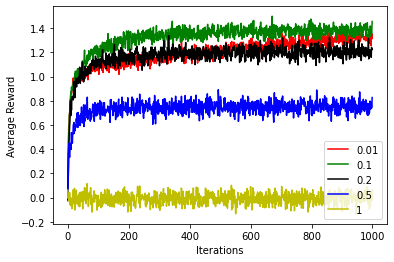

In [42]:
for i in range(len(epsilons)):
    plt.plot(avRs_INC[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('Average Reward')

Text(0, 0.5, '% of Optimal Action')

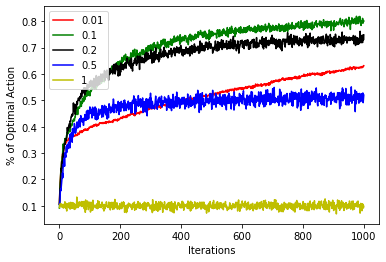

In [43]:
for i in range(len(epsilons)):
    plt.plot(Accs_INC[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('% of Optimal Action')

In [44]:
avRs_egreedy =[]
Accs_egreedy =[]
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [45]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='e-greedy_alpha',epsilon=epsilon,alpha=0.01)
    acc,avR = val.learn(1000)
    avRs_egreedy.append(avR)
    Accs_egreedy.append(acc)

Text(0, 0.5, '% of Optimal Action')

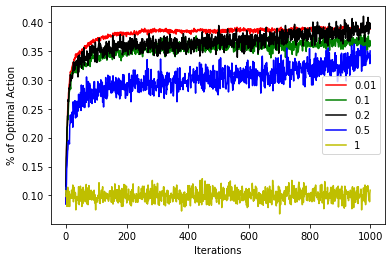

In [46]:
for i in range(len(epsilons)):
    plt.plot(Accs_egreedy[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('% of Optimal Action')

Text(0, 0.5, 'Average Reward')

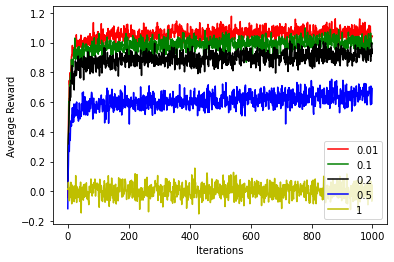

In [47]:
for i in range(len(epsilons)):
    plt.plot(avRs_egreedy[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('Average Reward')

In [48]:
avRs_UCB =[]
Accs_UCB =[]
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [49]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='UCB_INC',epsilon=epsilon,alpha=0.01,UCB_c=2)
    acc,avR = val.learn(1000)
    avRs_UCB.append(avR)
    Accs_UCB.append(acc)

In [54]:
avRs_grad =[]
Accs_grad =[]
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [59]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='gradient',epsilon=epsilon,alpha=0.01,UCB_c=2)
    acc,avR = val.learn(1000)
    avRs_grad.append(avR)
    Accs_grad.append(acc)

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1] [1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:76: RuntimeWarning: overflow encountered in exp
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide


ValueError: probabilities contain NaN

IndexError: list index out of range

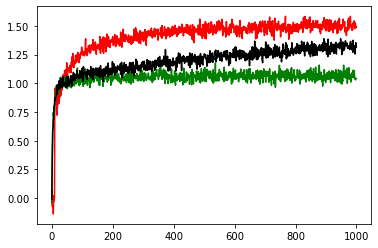

In [61]:
plt.plot(avRs_UCB[0],color='r')
plt.plot(avRs_egreedy[0],color='g')
plt.plot(avRs_INC[0],color='k')
plt.plot(avRs_grad[0],color='b')

In [19]:
avRs_INC =[]
Accs_INC = []
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [20]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='Incremental',epsilon=epsilon,alpha=0.01)
    acc,avR = val.learn(5000)
    avRs_INC.append(avR)
    Accs_INC.append(acc)

Text(0, 0.5, 'Average Reward')

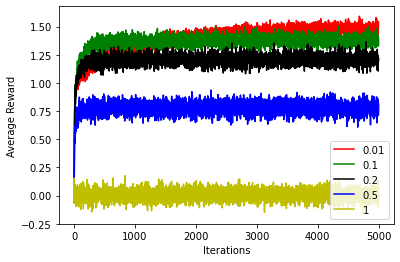

In [21]:
for i in range(len(epsilons)):
    plt.plot(avRs_INC[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('Average Reward')

Text(0, 0.5, '% of Optimal Action')

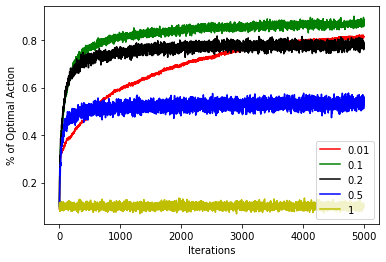

In [22]:
for i in range(len(epsilons)):
    plt.plot(Accs_INC[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('% of Optimal Action')

In [23]:
avRs_egreedy =[]
Accs_egreedy =[]
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [24]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='e-greedy_alpha',epsilon=epsilon,alpha=0.01)
    acc,avR = val.learn(5000)
    avRs_egreedy.append(avR)
    Accs_egreedy.append(acc)

Text(0, 0.5, 'Average Reward')

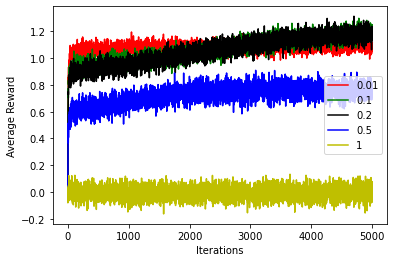

In [25]:
for i in range(len(epsilons)):
    plt.plot(avRs_egreedy[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('Average Reward')

Text(0, 0.5, '% of Optimal Action')

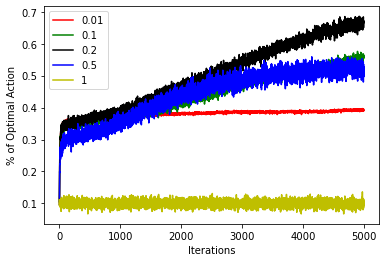

In [26]:
for i in range(len(epsilons)):
    plt.plot(Accs_egreedy[i],color=colors[i])
    plt.legend(epsilons)
plt.xlabel('Iterations')
plt.ylabel('% of Optimal Action')

In [27]:
avRs_UCB =[]
Accs_UCB =[]
colors = ['r','g','k','b','y']
epsilons = [0.01,0.1,0.2,0.5,1]

In [28]:
for epsilon in epsilons:
    val = ValueLearner(make_env,num_envs,method='UCB_INC',epsilon=epsilon,alpha=0.01,UCB_c=2)
    acc,avR = val.learn(5000)
    avRs_UCB.append(avR)
    Accs_UCB.append(acc)

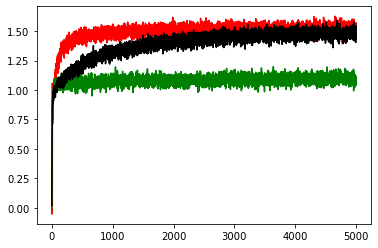

In [29]:
plt.plot(avRs_UCB[0],color='r')
plt.plot(avRs_egreedy[0],color='g')
plt.plot(avRs_INC[0],color='k')

2